# **Dataset Load and EDA**

Extracting dataset …
Loaded 1,200 records
       image_id                                         image_path   dx  \
0  ISIC_0031055  /content/custom_dataset_600/images/ISIC_003105...   nv   
1  ISIC_0024854  /content/custom_dataset_600/images/ISIC_002485...   nv   
2  ISIC_0031958  /content/custom_dataset_600/images/ISIC_003195...  mel   

   urgency_label    dx_type   age     sex     localization  
0              0  follow_up  60.0  female          abdomen  
1              0      histo  15.0    male             back  
2              1      histo  85.0  female  upper extremity  


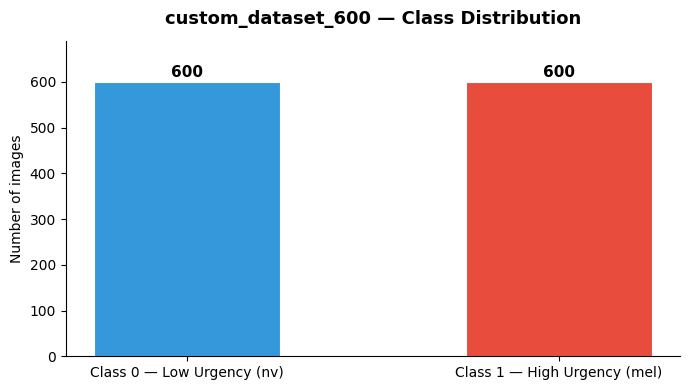


Class breakdown:
urgency_label
Class 0 — Low Urgency (nv)      600
Class 1 — High Urgency (mel)    600



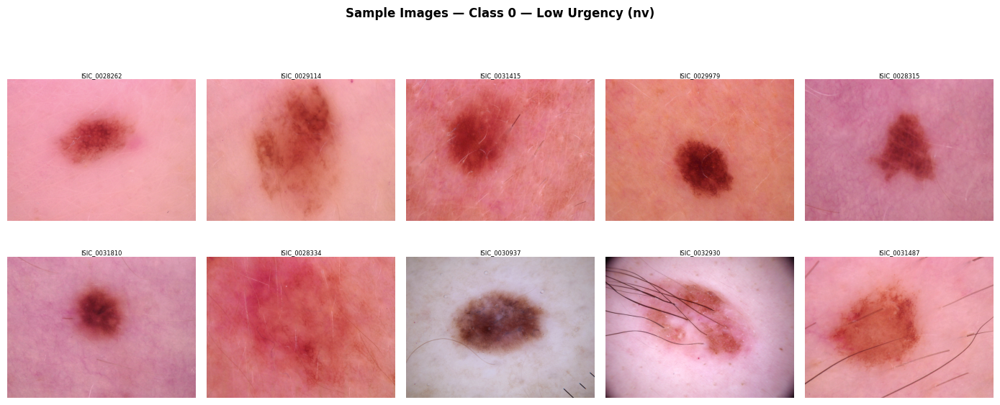

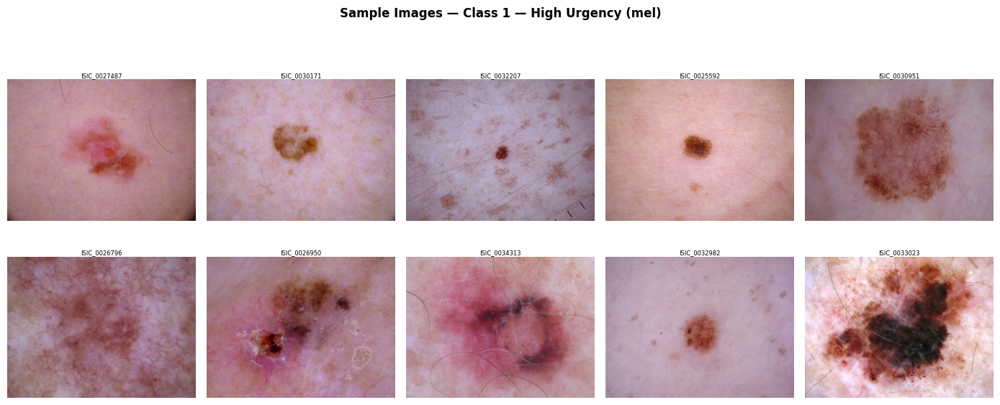

In [2]:
import zipfile
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from pathlib import Path

# ── 1. Unzip & load ───────────────────────────────────────────────────────────
ZIP_PATH  = "/content/custom_dataset_600.zip"   # ← upload this file to Colab
EXTRACT   = "/content"

print("Extracting dataset …")
with zipfile.ZipFile(ZIP_PATH, "r") as zf:
    zf.extractall(EXTRACT)

DATASET_DIR = Path(EXTRACT) / "custom_dataset_600"
CSV_PATH    = DATASET_DIR / "dataset_metadata.csv"

df = pd.read_csv(CSV_PATH)

# Fix image paths — extract just the filename, handles both Windows and Unix paths
df["image_path"] = df["image_path"].apply(
    lambda p: str(DATASET_DIR / "images" / p.replace("\\", "/").split("/")[-1])
)

print(f"Loaded {len(df):,} records")
print(df.head(3))
# ───────────────────────────────────────────────────────────



# ── 2. Class histogram ───────────────────────────────────────────────────────────
CLASS_NAMES = {0: "Class 0 — Low Urgency (nv)", 1: "Class 1 — High Urgency (mel)"}
counts      = df["urgency_label"].value_counts().sort_index()

fig, ax = plt.subplots(figsize=(7, 4))
bars = ax.bar(
    [CLASS_NAMES[i] for i in counts.index],
    counts.values,
    color=["#3498db", "#e74c3c"],
    edgecolor="white", linewidth=0.8, width=0.5
)
for bar, val in zip(bars, counts.values):
    ax.text(bar.get_x() + bar.get_width() / 2,
            bar.get_height() + 5, str(val),
            ha="center", va="bottom", fontsize=11, fontweight="bold")

ax.set_title("custom_dataset_600 — Class Distribution", fontsize=13, fontweight="bold", pad=12)
ax.set_ylabel("Number of images")
ax.set_ylim(0, counts.max() * 1.15)
ax.spines[["top", "right"]].set_visible(False)
plt.tight_layout()
plt.show()

print(f"\nClass breakdown:\n{counts.rename(CLASS_NAMES).to_string()}\n")
# ───────────────────────────────────────────────────────────


# ── 3. Sample grid — 10 images per class ─────────────────────────────────────
N_SAMPLES = 10

for label, group in df.groupby("urgency_label"):
    class_name = CLASS_NAMES[label]
    samples    = group.sample(n=N_SAMPLES, random_state=42)

    fig, axes = plt.subplots(2, 5, figsize=(14, 6))
    fig.suptitle(f"Sample Images — {class_name}",
                 fontsize=12, fontweight="bold", y=1.01)

    for ax, (_, row) in zip(axes.flat, samples.iterrows()):
        img = mpimg.imread(row["image_path"])
        ax.imshow(img)
        ax.set_title(row["image_id"], fontsize=6, pad=2)
        ax.axis("off")

    plt.tight_layout()
    plt.show()

# **Labels Generation**

/tmp/ipython-input-3115102164.py:14: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda g: g.sample(n=N_SAMPLES, random_state=SEED))


Fixed sample: 20 images (10 per class)
    image_id  dx  urgency_label
ISIC_0028262  nv              0
ISIC_0029114  nv              0
ISIC_0031415  nv              0
ISIC_0029979  nv              0
ISIC_0028315  nv              0
ISIC_0031810  nv              0
ISIC_0028334  nv              0
ISIC_0030937  nv              0
ISIC_0032930  nv              0
ISIC_0031487  nv              0
ISIC_0027487 mel              1
ISIC_0030171 mel              1
ISIC_0032207 mel              1
ISIC_0025592 mel              1
ISIC_0030951 mel              1
ISIC_0026796 mel              1
ISIC_0026950 mel              1
ISIC_0034313 mel              1
ISIC_0032982 mel              1
ISIC_0033023 mel              1


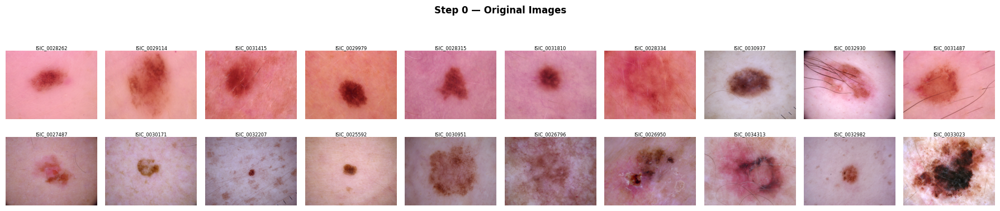

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from pathlib import Path

SEED      = 42
N_SAMPLES = 10
CLASS_NAMES = {0: "Low Urgency (nv)", 1: "High Urgency (mel)"}

# Fix the sample once — reused in every subsequent cell
samples = (
    df.groupby("urgency_label", group_keys=False)
      .apply(lambda g: g.sample(n=N_SAMPLES, random_state=SEED))
      .reset_index(drop=True)
)

print(f"Fixed sample: {len(samples)} images ({N_SAMPLES} per class)")
print(samples[["image_id", "dx", "urgency_label"]].to_string(index=False))


# ── Shared display helper ──────────────────────────────────────────────────────
def show_grid(images, titles, suptitle, cmap=None):
    """Display a 2×10 grid (row 0 = class 0, row 1 = class 1)."""
    fig, axes = plt.subplots(2, N_SAMPLES, figsize=(18, 4))
    fig.suptitle(suptitle, fontsize=12, fontweight="bold", y=1.01)
    for i, (img, title, ax) in enumerate(zip(images, titles, axes.flat)):
        ax.imshow(img, cmap=cmap)
        ax.set_title(title, fontsize=6, pad=2)
        ax.axis("off")
    # Row labels
    axes[0, 0].set_ylabel("Class 0 (nv)", fontsize=8, labelpad=4)
    axes[1, 0].set_ylabel("Class 1 (mel)", fontsize=8, labelpad=4)
    plt.tight_layout()
    plt.show()


# ── Step 0: show originals as baseline ────────────────────────────────────────
originals, orig_titles = [], []
for _, row in samples.iterrows():
    img = cv2.cvtColor(cv2.imread(row["image_path"]), cv2.COLOR_BGR2RGB)
    originals.append(img)
    orig_titles.append(row["image_id"])

show_grid(originals, orig_titles, "Step 0 — Original Images")

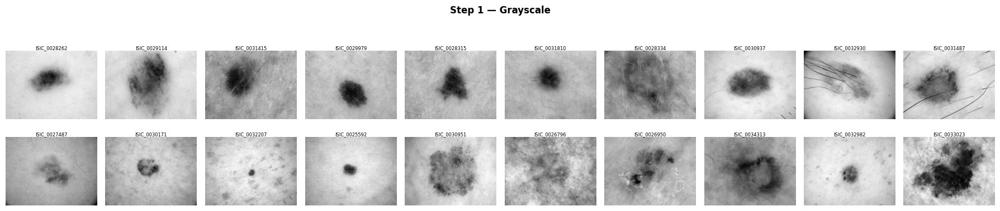

Image shape after grayscale: (450, 600)  (H × W, single channel)


In [4]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 2B — Step 1: Grayscale conversion                         ║
# ╚══════════════════════════════════════════════════════════════════╝

gray_imgs = []
for img in originals:
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray_imgs.append(gray)

show_grid(gray_imgs, orig_titles, "Step 1 — Grayscale", cmap="gray")
print(f"Image shape after grayscale: {gray_imgs[0].shape}  (H × W, single channel)")

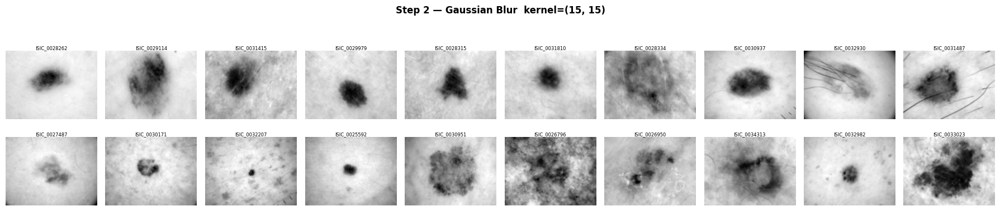

Blur kernel : (15, 15)


In [5]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 2C — Step 2: Gaussian Blur                                ║
# ╚══════════════════════════════════════════════════════════════════╝
# Kernel (15,15) large enough to suppress hair and minor texture noise
# without destroying lesion boundaries.

BLUR_KERNEL = (15, 15)

blurred_imgs = []
for gray in gray_imgs:
    blurred = cv2.GaussianBlur(gray, BLUR_KERNEL, 0)
    blurred_imgs.append(blurred)

show_grid(blurred_imgs, orig_titles,
          f"Step 2 — Gaussian Blur  kernel={BLUR_KERNEL}", cmap="gray")
print(f"Blur kernel : {BLUR_KERNEL}")

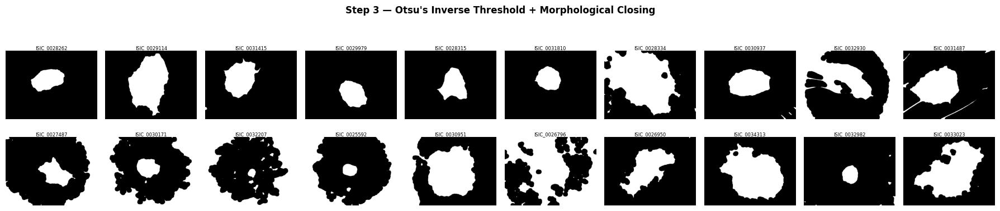

White pixels = foreground (lesion candidate)
Black pixels = background (skin)


In [6]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 2D — Step 3: Otsu's Thresholding (Inverse)               ║
# ╚══════════════════════════════════════════════════════════════════╝
# THRESH_BINARY_INV: dark lesion pixels → white (255), bright skin → black (0)
# After thresholding, apply morphological CLOSING (dilation then erosion)
# to fill internal holes and connect fragmented lesion regions.

MORPH_KERNEL = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))

thresh_imgs = []
for blurred in blurred_imgs:
    _, thresh = cv2.threshold(blurred, 0, 255,
                              cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    # Morphological closing: fills holes inside the lesion mask
    closed = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, MORPH_KERNEL,
                               iterations=2)
    thresh_imgs.append(closed)

show_grid(thresh_imgs, orig_titles,
          "Step 3 — Otsu's Inverse Threshold + Morphological Closing",
          cmap="gray")
print("White pixels = foreground (lesion candidate)")
print("Black pixels = background (skin)")


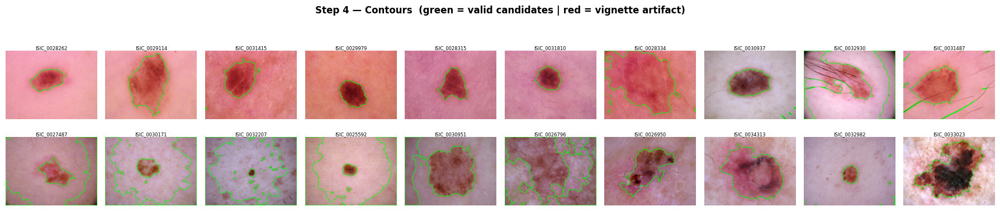

Vignette filter: contours covering >85% of image area are discarded (shown in red)


In [7]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 2E — Step 4: Find Contours                                ║
# ╚══════════════════════════════════════════════════════════════════╝
# Draw ALL contours found on the original image so we can see
# what the algorithm is "seeing" before we pick the best one.

MAX_AREA_RATIO = 0.85   # contours covering >85 % of image = vignette artifact

contour_viz = []
for img, thresh in zip(originals, thresh_imgs):
    h, w     = thresh.shape
    total_px = h * w
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL,
                                    cv2.CHAIN_APPROX_SIMPLE)

    canvas = img.copy()
    valid  = [c for c in contours
              if cv2.contourArea(c) / total_px < MAX_AREA_RATIO]

    cv2.drawContours(canvas, valid, -1, (0, 255, 0), 2)     # valid → green
    invalid = [c for c in contours
               if cv2.contourArea(c) / total_px >= MAX_AREA_RATIO]
    cv2.drawContours(canvas, invalid, -1, (255, 0, 0), 2)   # vignette → red

    contour_viz.append(canvas)

show_grid(contour_viz, orig_titles,
          "Step 4 — Contours  (green = valid candidates | red = vignette artifact)")
print(f"Vignette filter: contours covering >{MAX_AREA_RATIO*100:.0f}% of image area are discarded (shown in red)")

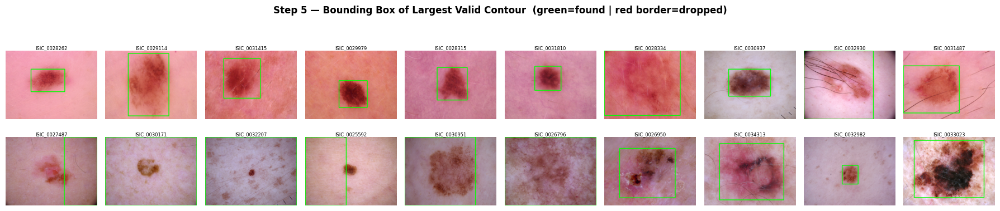

✅  All sample images had a valid contour.


In [8]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 2F — Step 5: Largest Valid Contour → Bounding Box         ║
# ╚══════════════════════════════════════════════════════════════════╝
# Pick the largest contour that passes the vignette filter,
# draw its bounding rectangle on the original image.

bbox_viz    = []
dropped_ids = []

for img, thresh, (_, row) in zip(originals, thresh_imgs, samples.iterrows()):
    h, w     = thresh.shape
    total_px = h * w
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL,
                                    cv2.CHAIN_APPROX_SIMPLE)

    valid = [c for c in contours
             if cv2.contourArea(c) / total_px < MAX_AREA_RATIO]

    canvas = img.copy()

    if not valid:
        dropped_ids.append(row["image_id"])
        # Red border to flag dropped image in the grid
        cv2.rectangle(canvas, (0, 0), (w - 1, h - 1), (255, 0, 0), 6)
    else:
        best = max(valid, key=cv2.contourArea)
        x, y, bw, bh = cv2.boundingRect(best)
        cv2.rectangle(canvas, (x, y), (x + bw, y + bh), (0, 255, 0), 3)

    bbox_viz.append(canvas)

show_grid(bbox_viz, orig_titles,
          "Step 5 — Bounding Box of Largest Valid Contour  (green=found | red border=dropped)")

if dropped_ids:
    print(f"\n⚠  Dropped in sample ({len(dropped_ids)}) : {dropped_ids}")
else:
    print("✅  All sample images had a valid contour.")

In [9]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 2G — Step 6: Normalize & Generate YOLO Labels (full df)   ║
# ╚══════════════════════════════════════════════════════════════════╝
# YOLO format per line:  <class> <cx> <cy> <w> <h>   (all 0-1 relative)
# Output: DATASET_DIR / yolo_labels / <image_id>.txt

LABELS_DIR = DATASET_DIR / "yolo_labels"
LABELS_DIR.mkdir(exist_ok=True)

processed, dropped_full = 0, []

for _, row in df.iterrows():
    img_bgr = cv2.imread(row["image_path"])
    if img_bgr is None:
        dropped_full.append(row["image_id"])
        continue

    h, w    = img_bgr.shape[:2]
    total_px = h * w
    gray     = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
    blurred  = cv2.GaussianBlur(gray, BLUR_KERNEL, 0)
    _, thresh = cv2.threshold(blurred, 0, 255,
                               cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    closed   = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, MORPH_KERNEL,
                                  iterations=2)
    contours, _ = cv2.findContours(closed, cv2.RETR_EXTERNAL,
                                    cv2.CHAIN_APPROX_SIMPLE)

    valid = [c for c in contours
             if cv2.contourArea(c) / total_px < MAX_AREA_RATIO]

    if not valid:
        dropped_full.append(row["image_id"])
        continue

    best        = max(valid, key=cv2.contourArea)
    x, y, bw, bh = cv2.boundingRect(best)

    # Normalize to 0-1  (YOLO expects centre-x, centre-y, width, height)
    cx  = (x + bw / 2) / w
    cy  = (y + bh / 2) / h
    nw  = bw / w
    nh  = bh / h

    # Clamp to [0, 1] for safety
    cx, cy, nw, nh = (min(max(v, 0.0), 1.0) for v in (cx, cy, nw, nh))

    label_path = LABELS_DIR / f"{row['image_id']}.txt"
    with open(label_path, "w") as f:
        f.write(f"{int(row['urgency_label'])} {cx:.6f} {cy:.6f} {nw:.6f} {nh:.6f}\n")

    processed += 1

In [10]:
# ── Report ─────────────────────────────────────────────────────────────────────
total   = len(df)
kept    = processed
dropped = len(dropped_full)

print("=" * 52)
print("  YOLO LABEL GENERATION — REPORT")
print("=" * 52)
print(f"  Total images processed : {total:>5,}")
print(f"  Labels saved           : {kept:>5,}  ({kept/total*100:.1f}%)")
print(f"  Images dropped         : {dropped:>5,}  ({dropped/total*100:.1f}%)")
print(f"  Output directory       : {LABELS_DIR}")
print("=" * 52)

if dropped_full:
    print(f"\nDropped image IDs ({len(dropped_full)}):")
    for iid in dropped_full:
        print(f"  • {iid}")

  YOLO LABEL GENERATION — REPORT
  Total images processed : 1,200
  Labels saved           : 1,200  (100.0%)
  Images dropped         :     0  (0.0%)
  Output directory       : /content/custom_dataset_600/yolo_labels


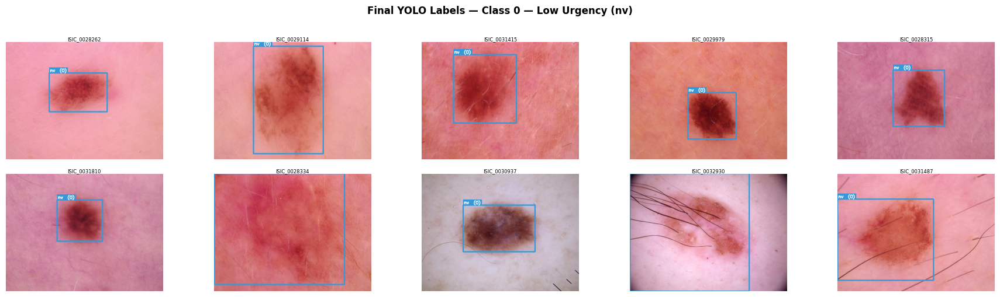

  ✅  All 10 images in 'Class 0 — Low Urgency (nv)' have valid labels.


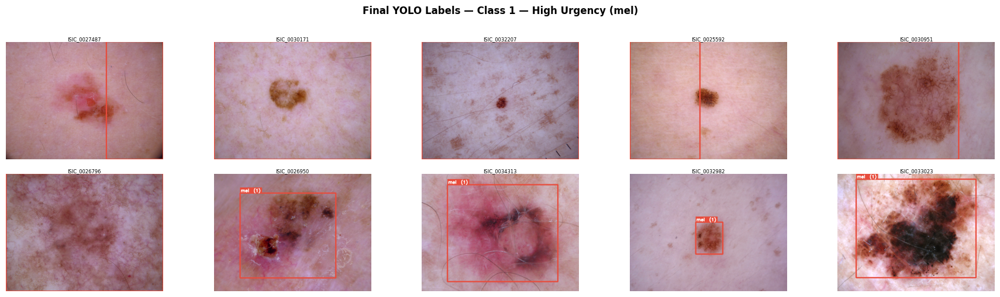

  ✅  All 10 images in 'Class 1 — High Urgency (mel)' have valid labels.


In [11]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 2H — Visualise final YOLO labels (bbox + class label)     ║
# ╚══════════════════════════════════════════════════════════════════╝
# Reads the generated .txt files back and draws the normalised bbox
# on the original image — what YOLO will actually train on.

CLASS_COLORS = {
    0: (52,  152, 219),   # blue  — Low Urgency  (nv)
    1: (231, 76,  60),    # red   — High Urgency (mel)
}
CLASS_LABELS = {
    0: "Class 0 — Low Urgency (nv)",
    1: "Class 1 — High Urgency (mel)",
}

def draw_yolo_bbox(img_rgb, label_path):
    """
    Read a YOLO .txt label and draw the bounding box + class tag.
    Returns the annotated image, or None if the label file is missing.
    """
    if not Path(label_path).exists():
        return None

    with open(label_path) as f:
        parts = f.readline().split()

    cls, cx, cy, nw, nh = int(parts[0]), *map(float, parts[1:])

    h, w = img_rgb.shape[:2]
    x1 = int((cx - nw / 2) * w)
    y1 = int((cy - nh / 2) * h)
    x2 = int((cx + nw / 2) * w)
    y2 = int((cy + nh / 2) * h)

    canvas = img_rgb.copy()
    color  = CLASS_COLORS[cls]

    cv2.rectangle(canvas, (x1, y1), (x2, y2), color, 3)

    # Tag background + text
    tag   = f"{'mel' if cls == 1 else 'nv'}  ({cls})"
    (tw, th), _ = cv2.getTextSize(tag, cv2.FONT_HERSHEY_SIMPLEX, 0.55, 2)
    cv2.rectangle(canvas, (x1, y1 - th - 8), (x1 + tw + 6, y1), color, -1)
    cv2.putText(canvas, tag, (x1 + 3, y1 - 4),
                cv2.FONT_HERSHEY_SIMPLEX, 0.55, (255, 255, 255), 2)

    return canvas


for label_id, group in samples.groupby("urgency_label"):
    fig, axes = plt.subplots(2, N_SAMPLES // 2, figsize=(18, 5))
    fig.suptitle(f"Final YOLO Labels — {CLASS_LABELS[label_id]}",
                 fontsize=12, fontweight="bold", y=1.01)

    no_label = []
    for ax, (_, row) in zip(axes.flat, group.iterrows()):
        label_path = LABELS_DIR / f"{row['image_id']}.txt"
        img_rgb    = cv2.cvtColor(cv2.imread(row["image_path"]), cv2.COLOR_BGR2RGB)
        annotated  = draw_yolo_bbox(img_rgb, label_path)

        if annotated is None:
            # Grey out dropped images
            ax.imshow(np.full_like(img_rgb, 40))
            ax.set_title(f"{row['image_id']}\n⚠ no label", fontsize=6,
                         color="red", pad=2)
            no_label.append(row["image_id"])
        else:
            ax.imshow(annotated)
            ax.set_title(row["image_id"], fontsize=6, pad=2)

        ax.axis("off")

    plt.tight_layout()
    plt.show()

    if no_label:
        print(f"  ⚠  {len(no_label)} image(s) had no label file: {no_label}")
    else:
        print(f"  ✅  All {N_SAMPLES} images in '{CLASS_LABELS[label_id]}' have valid labels.")

# **BBOX Evaluation**

**Bbox Sanity Metrics:**
Since we generated our bounding boxes automatically using classical computer vision (Otsu's thresholding) rather than drawing them by hand, we have no guarantee that every box actually landed on the right region. Cell 4A evaluates the quality of all generated boxes purely by looking at their geometry — no ground truth labels needed. For each box, we compute three numbers: coverage (what fraction of the total image the box covers), aspect ratio (how wide the box is relative to its height), and centre deviation (how far the centre of the box is from the centre of the image). We then flag any box that looks suspicious: a box covering more than 85% of the image is almost certainly the dark vignette ring from the dermoscope lens rather than a lesion; a box covering less than 2% is likely noise; an extreme aspect ratio suggests the contour algorithm locked onto a hair or scratch instead of the lesion; and a large centre deviation suggests the box drifted to the edge of the image where real lesions rarely sit. The distribution histograms let you see at a glance whether these problems are rare edge cases or a systematic pattern. Ideally, you want coverage values clustered between roughly 0.05 and 0.60, aspect ratios close to 1.0, and centre deviations close to 0 — all of which would tell you the pipeline is consistently finding a reasonably-sized, roughly-centred region in the middle of the image, which is exactly where a dermatoscope-captured lesion should be.

Labels parsed : 1,200
       coverage  aspect_ratio  centre_dev
count  1200.000      1200.000    1200.000
mean      0.381         1.115       0.093
std       0.252         0.376       0.100
min       0.021         0.244       0.000
25%       0.184         0.880       0.031
50%       0.326         1.096       0.058
75%       0.531         1.333       0.114
max       1.000         4.027       0.553

── Outlier Summary ────────────────────────────────
  Coverage > 85% (vignette)   :   86  (7.2%)
  Coverage < 2%  (noise)      :    0  (0.0%)
  Extreme aspect ratio           :    0  (0.0%)
  Large centre deviation         :   55  (4.6%)
  ── Any flag (total unique)     :  141  (11.8%)
  ── Clean labels                : 1059  (88.2%)


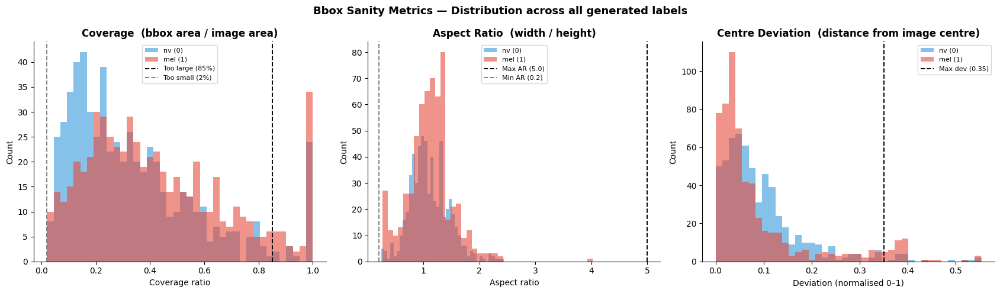


Metrics CSV saved → /content/custom_dataset_600/bbox_sanity_metrics.csv


In [20]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 4A — Bbox Sanity Metrics (No GT needed)                   ║
# ╚══════════════════════════════════════════════════════════════════╝

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from pathlib import Path
from PIL import Image

LABELS_DIR = DATASET_DIR / "yolo_labels"   # from Cell 2G

# ── Parse all generated label files ──────────────────────────────────────────
records = []

for label_path in LABELS_DIR.glob("*.txt"):
    image_id = label_path.stem
    row      = df[df["image_id"] == image_id]
    if row.empty:
        continue

    img_path = Path(row.iloc[0]["image_path"])
    try:
        img_w, img_h = Image.open(img_path).size
    except Exception:
        continue

    with open(label_path) as f:
        parts = f.readline().strip().split()

    cls, cx, cy, nw, nh = int(parts[0]), *map(float, parts[1:])

    bbox_area   = (nw * img_w) * (nh * img_h)
    image_area  = img_w * img_h
    coverage    = bbox_area / image_area
    aspect_ratio = (nw * img_w) / (nh * img_h + 1e-6)
    centre_dev_x = abs(cx - 0.5)   # deviation from image centre (0 = centred)
    centre_dev_y = abs(cy - 0.5)
    centre_dev   = np.sqrt(centre_dev_x**2 + centre_dev_y**2)

    records.append({
        "image_id"    : image_id,
        "urgency_label": cls,
        "cx"          : cx,
        "cy"          : cy,
        "nw"          : nw,
        "nh"          : nh,
        "coverage"    : coverage,
        "aspect_ratio": aspect_ratio,
        "centre_dev"  : centre_dev,
    })

metrics_df = pd.DataFrame(records)
print(f"Labels parsed : {len(metrics_df):,}")
print(metrics_df[["coverage", "aspect_ratio", "centre_dev"]].describe().round(3))

# ── Flag outliers ─────────────────────────────────────────────────────────────
TOO_LARGE   = 0.85    # coverage > 85 %  → likely vignette
TOO_SMALL   = 0.02    # coverage < 2  %  → likely noise
AR_MAX      = 5.0     # aspect ratio > 5 → extreme shape
AR_MIN      = 0.2     # aspect ratio < 0.2
DEV_MAX     = 0.35    # centre deviation > 0.35 → far from centre

metrics_df["flag_too_large"]  = metrics_df["coverage"]     > TOO_LARGE
metrics_df["flag_too_small"]  = metrics_df["coverage"]     < TOO_SMALL
metrics_df["flag_aspect"]     = (metrics_df["aspect_ratio"] > AR_MAX) | \
                                 (metrics_df["aspect_ratio"] < AR_MIN)
metrics_df["flag_centre"]     = metrics_df["centre_dev"]   > DEV_MAX
metrics_df["any_flag"]        = (metrics_df["flag_too_large"] |
                                  metrics_df["flag_too_small"] |
                                  metrics_df["flag_aspect"]    |
                                  metrics_df["flag_centre"])

total   = len(metrics_df)
flagged = metrics_df["any_flag"].sum()

print(f"\n── Outlier Summary ────────────────────────────────")
print(f"  Coverage > {TOO_LARGE:.0%} (vignette)   : "
      f"{metrics_df['flag_too_large'].sum():>4}  "
      f"({metrics_df['flag_too_large'].mean()*100:.1f}%)")
print(f"  Coverage < {TOO_SMALL:.0%}  (noise)      : "
      f"{metrics_df['flag_too_small'].sum():>4}  "
      f"({metrics_df['flag_too_small'].mean()*100:.1f}%)")
print(f"  Extreme aspect ratio           : "
      f"{metrics_df['flag_aspect'].sum():>4}  "
      f"({metrics_df['flag_aspect'].mean()*100:.1f}%)")
print(f"  Large centre deviation         : "
      f"{metrics_df['flag_centre'].sum():>4}  "
      f"({metrics_df['flag_centre'].mean()*100:.1f}%)")
print(f"  ── Any flag (total unique)     : "
      f"{flagged:>4}  ({flagged/total*100:.1f}%)")
print(f"  ── Clean labels                : "
      f"{total-flagged:>4}  ({(total-flagged)/total*100:.1f}%)")

# ── Distribution plots ────────────────────────────────────────────────────────
fig, axes = plt.subplots(1, 3, figsize=(17, 5))
fig.suptitle("Bbox Sanity Metrics — Distribution across all generated labels",
             fontsize=13, fontweight="bold")

colors_cls = metrics_df["urgency_label"].map({0: "#3498db", 1: "#e74c3c"})

def vline(ax, x, label, color="black"):
    ax.axvline(x, color=color, linestyle="--", linewidth=1.4, label=label)

# Coverage
ax = axes[0]
ax.hist(metrics_df[metrics_df["urgency_label"]==0]["coverage"],
        bins=40, alpha=0.6, color="#3498db", label="nv (0)")
ax.hist(metrics_df[metrics_df["urgency_label"]==1]["coverage"],
        bins=40, alpha=0.6, color="#e74c3c", label="mel (1)")
vline(ax, TOO_LARGE, f"Too large ({TOO_LARGE:.0%})", "black")
vline(ax, TOO_SMALL, f"Too small ({TOO_SMALL:.0%})", "gray")
ax.set_title("Coverage  (bbox area / image area)", fontweight="bold")
ax.set_xlabel("Coverage ratio"); ax.set_ylabel("Count")
ax.legend(fontsize=8); ax.spines[["top","right"]].set_visible(False)

# Aspect ratio (log scale — easier to read)
ax = axes[1]
ax.hist(metrics_df[metrics_df["urgency_label"]==0]["aspect_ratio"],
        bins=40, alpha=0.6, color="#3498db", label="nv (0)")
ax.hist(metrics_df[metrics_df["urgency_label"]==1]["aspect_ratio"],
        bins=40, alpha=0.6, color="#e74c3c", label="mel (1)")
vline(ax, AR_MAX, f"Max AR ({AR_MAX})", "black")
vline(ax, AR_MIN, f"Min AR ({AR_MIN})", "gray")
ax.set_title("Aspect Ratio  (width / height)", fontweight="bold")
ax.set_xlabel("Aspect ratio"); ax.set_ylabel("Count")
ax.legend(fontsize=8); ax.spines[["top","right"]].set_visible(False)

# Centre deviation
ax = axes[2]
ax.hist(metrics_df[metrics_df["urgency_label"]==0]["centre_dev"],
        bins=40, alpha=0.6, color="#3498db", label="nv (0)")
ax.hist(metrics_df[metrics_df["urgency_label"]==1]["centre_dev"],
        bins=40, alpha=0.6, color="#e74c3c", label="mel (1)")
vline(ax, DEV_MAX, f"Max dev ({DEV_MAX})", "black")
ax.set_title("Centre Deviation  (distance from image centre)", fontweight="bold")
ax.set_xlabel("Deviation (normalised 0–1)"); ax.set_ylabel("Count")
ax.legend(fontsize=8); ax.spines[["top","right"]].set_visible(False)

plt.tight_layout()
plt.savefig(DATASET_DIR / "bbox_sanity_metrics.png", dpi=150, bbox_inches="tight")
plt.show()

# Save flagged list for the spot-check cell
metrics_df.to_csv(DATASET_DIR / "bbox_sanity_metrics.csv", index=False)
print(f"\nMetrics CSV saved → {DATASET_DIR / 'bbox_sanity_metrics.csv'}")


**Visual Spot-Check Scoring:**
Numbers alone can miss things that a human eye catches instantly, so Cell 4B adds a manual review layer on top of the geometric analysis. It selects a stratified sample of 50 images — 25 from each class — and deliberately skews the sample toward the geometrically flagged images from Cell 4A, since those are the ones most likely to have a bad box. Each image is displayed with its generated bounding box drawn on top, along with its coverage and aspect ratio values printed underneath, so you can cross-reference the numbers with what you actually see. After reviewing the grids, you open the saved spot_check_scores.csv and assign each image a score of 2 (Good) if the box tightly surrounds the lesion, 1 (Partial) if the lesion is inside the box but the box is too loose or slightly off, or 0 (Bad) if the box completely misses the lesion or covers the whole image. Once scored, the summary snippet at the bottom tells you your overall good-bbox rate — the percentage of boxes that earned a 2. A rate above 70% is a reasonable signal that the Otsu pipeline is producing usable weak labels for YOLO training, while a rate below 50% would suggest the pipeline needs refinement (stronger morphological operations, tighter vignette filtering, or switching to a different thresholding strategy) before the labels are trustworthy enough to train on.

/tmp/ipython-input-4122675531.py:44: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda g: pd.concat([


Spot-check sample: 50 images ({0: 25, 1: 25})
  Includes flagged: 16 images



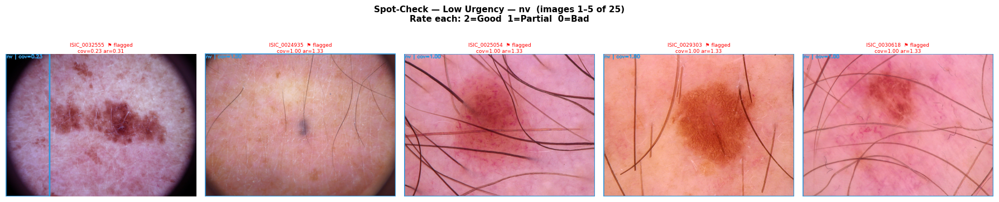

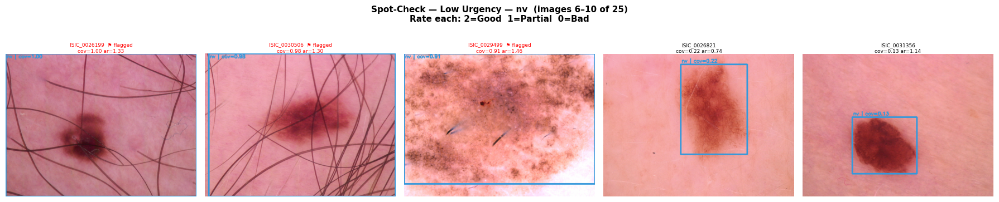

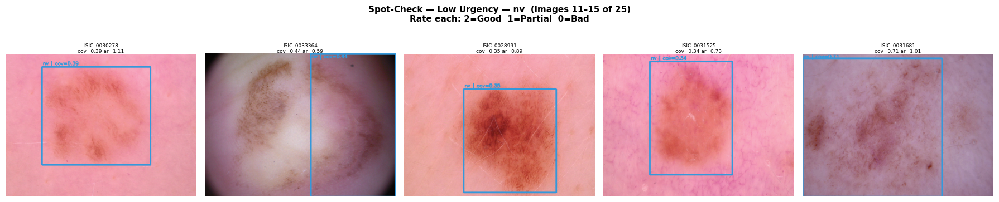

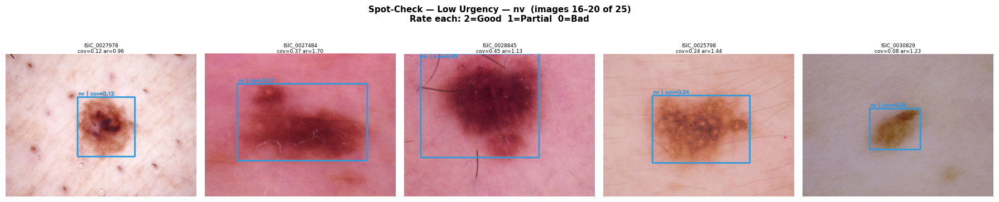

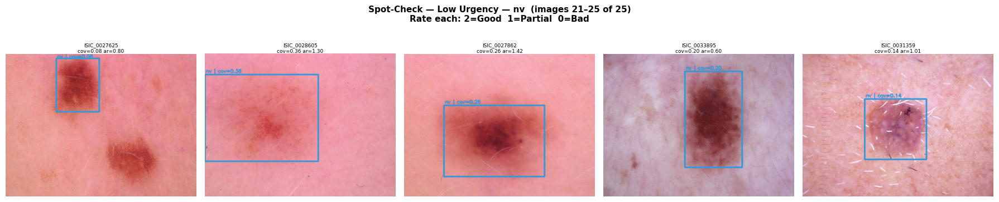

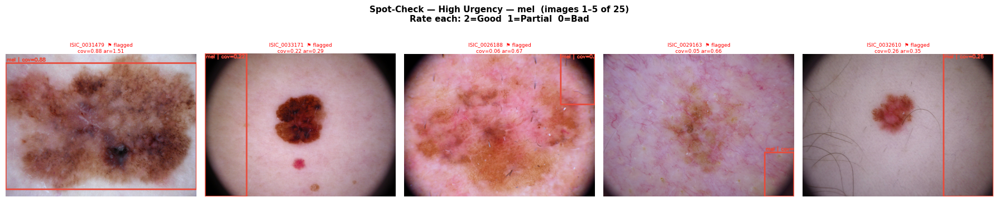

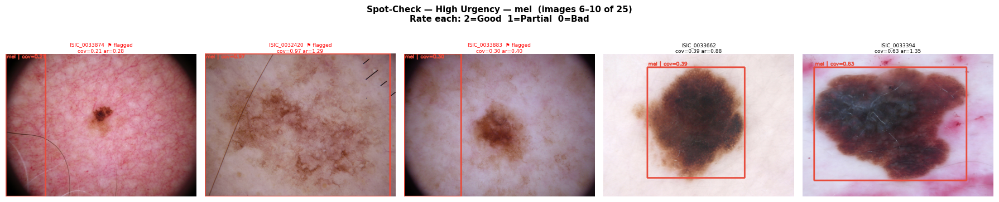

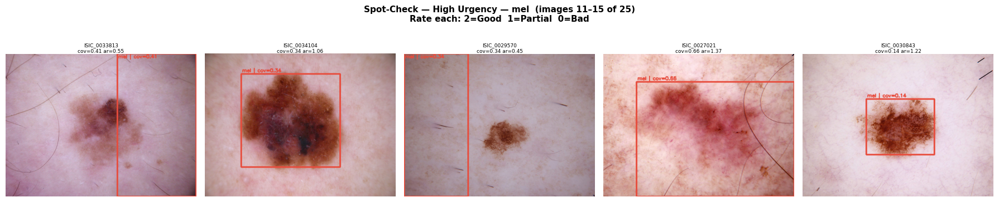

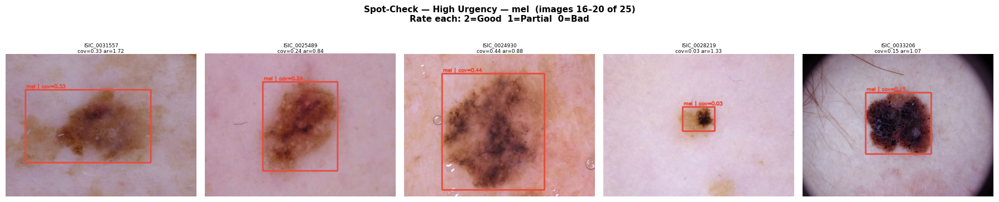

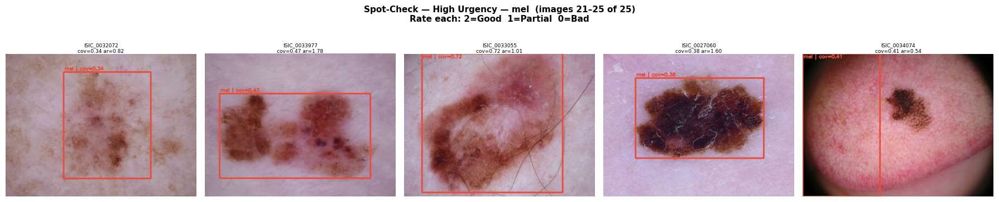

  SPOT-CHECK SCORING RUBRIC
  2 — Good     : box tightly surrounds the lesion
  1 — Partial  : lesion included but box too large
                 or slightly off-centre
  0 — Bad      : lesion missed / whole image covered

  Scoring template saved → /content/custom_dataset_600/spot_check_scores.csv
  Fill in the 'score' column and re-load to compute stats.

  To compute summary stats after scoring, run:

  scored = pd.read_csv(score_path)
  scored["score"] = pd.to_numeric(scored["score"])
  print(scored["score"].value_counts().sort_index()
        .rename({2:'Good',1:'Partial',0:'Bad'}))
  good_pct = (scored["score"]==2).mean()*100
  print(f"Good bbox rate: {good_pct:.1f}%")



In [21]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 4B — Visual Spot-Check Scoring                            ║
# ╚══════════════════════════════════════════════════════════════════╝
# Displays a random stratified sample of 50 images (25 per class).
# Each image is shown with its bbox so you can rate it visually.
# After reviewing, the scoring rubric is printed and a scored CSV is saved.
#
# Scoring rubric:
#   2 — Good    : box tightly surrounds the lesion
#   1 — Partial : box includes the lesion but is too large / slightly off
#   0 — Bad     : box misses the lesion or covers the whole image

import cv2
import random

SPOT_N      = 25    # per class
SPOT_SEED   = 99

random.seed(SPOT_SEED)

def draw_bbox_on_image(img_path, label_path):
    img_bgr = cv2.imread(str(img_path))
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    h, w    = img_rgb.shape[:2]
    canvas  = img_rgb.copy()

    if Path(label_path).exists():
        with open(label_path) as f:
            parts = f.readline().strip().split()
        cls, cx, cy, nw, nh = int(parts[0]), *map(float, parts[1:])
        x1 = int((cx - nw/2) * w); y1 = int((cy - nh/2) * h)
        x2 = int((cx + nw/2) * w); y2 = int((cy + nh/2) * h)
        color = (231, 76, 60) if cls == 1 else (52, 152, 219)
        cv2.rectangle(canvas, (x1, y1), (x2, y2), color, 3)
        tag = f"{'mel' if cls==1 else 'nv'} | cov={nw*nh:.2f}"
        cv2.putText(canvas, tag, (x1+3, max(y1-6, 14)),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    return canvas


# Sample 25 per class, prefer flagged images to stress-test_images edge cases
spot_sample = (
    metrics_df.groupby("urgency_label", group_keys=False)
    .apply(lambda g: pd.concat([
        g[g["any_flag"]].sample(min(8, len(g[g["any_flag"]])),
                                random_state=SPOT_SEED),
        g[~g["any_flag"]].sample(
            min(SPOT_N - min(8, len(g[g["any_flag"]])),
                len(g[~g["any_flag"]])),
            random_state=SPOT_SEED)
    ]).head(SPOT_N))
    .reset_index(drop=True)
)

print(f"Spot-check sample: {len(spot_sample)} images "
      f"({spot_sample['urgency_label'].value_counts().to_dict()})")
print(f"  Includes flagged: {spot_sample['any_flag'].sum()} images\n")

CLASS_LABEL = {0: "Low Urgency — nv", 1: "High Urgency — mel"}

for cls_id, group in spot_sample.groupby("urgency_label"):
    rows_of_5 = [group.iloc[i:i+5] for i in range(0, len(group), 5)]
    for chunk_idx, chunk in enumerate(rows_of_5):
        fig, axes = plt.subplots(1, 5, figsize=(18, 4))
        fig.suptitle(
            f"Spot-Check — {CLASS_LABEL[cls_id]}  "
            f"(images {chunk_idx*5+1}–{chunk_idx*5+len(chunk)} of {SPOT_N})\n"
            f"Rate each: 2=Good  1=Partial  0=Bad",
            fontsize=11, fontweight="bold"
        )
        for ax, (_, row) in zip(axes, chunk.iterrows()):
            img_path   = DATASET_DIR / "images" / f"{row['image_id']}.jpg"
            label_path = LABELS_DIR  / f"{row['image_id']}.txt"
            canvas     = draw_bbox_on_image(img_path, label_path)

            # Red asterisk on flagged images
            flag_tag = "  ⚑ flagged" if row["any_flag"] else ""
            cov_tag  = f"cov={row['coverage']:.2f} ar={row['aspect_ratio']:.2f}"

            ax.imshow(canvas)
            ax.set_title(f"{row['image_id'][:14]}{flag_tag}\n{cov_tag}",
                         fontsize=6.5, pad=2,
                         color="red" if row["any_flag"] else "black")
            ax.axis("off")

        for ax in axes[len(chunk):]:
            ax.axis("off")

        plt.tight_layout()
        plt.show()

# ── Scoring template ──────────────────────────────────────────────────────────
score_template = spot_sample[["image_id", "urgency_label",
                               "coverage", "aspect_ratio",
                               "centre_dev", "any_flag"]].copy()
score_template["score"]   = ""   # fill in: 2=Good, 1=Partial, 0=Bad
score_template["comment"] = ""   # optional notes

score_path = DATASET_DIR / "spot_check_scores.csv"
score_template.to_csv(score_path, index=False)

print("=" * 55)
print("  SPOT-CHECK SCORING RUBRIC")
print("=" * 55)
print("  2 — Good     : box tightly surrounds the lesion")
print("  1 — Partial  : lesion included but box too large")
print("                 or slightly off-centre")
print("  0 — Bad      : lesion missed / whole image covered")
print("=" * 55)
print(f"\n  Scoring template saved → {score_path}")
print("  Fill in the 'score' column and re-load to compute stats.\n")

print("  To compute summary stats after scoring, run:")
print("""
  scored = pd.read_csv(score_path)
  scored["score"] = pd.to_numeric(scored["score"])
  print(scored["score"].value_counts().sort_index()
        .rename({2:'Good',1:'Partial',0:'Bad'}))
  good_pct = (scored["score"]==2).mean()*100
  print(f"Good bbox rate: {good_pct:.1f}%")
""")

# **Model Training**

In [12]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 3A — Train / Validation / Test Split                      ║
# ╚══════════════════════════════════════════════════════════════════╝
# Builds the YOLO folder structure and writes data.yaml.
#
# Split ratios : 70% train | 15% val | 15% test_images  (stratified by class)
#
# Output layout:
#   /content/yolo_dataset/
#   ├── data.yaml
#   ├── images/  train/  val/  test_images/
#   └── labels/  train/  val/  test_images/

import shutil
import yaml
import pandas as pd
from pathlib import Path
from sklearn.model_selection import train_test_split

# ── Only keep rows that have a label file ─────────────────────────────────────
df_labeled = df[
    df["image_id"].apply(lambda iid: (LABELS_DIR / f"{iid}.txt").exists())
].reset_index(drop=True)

print(f"Images with YOLO labels : {len(df_labeled):,}  "
      f"(dropped {len(df) - len(df_labeled):,} without labels)")

# ── Stratified split ──────────────────────────────────────────────────────────
TRAIN_RATIO = 0.70
VAL_RATIO   = 0.15   # test_images gets the remainder (0.15)
SEED        = 42

train_df, temp_df = train_test_split(
    df_labeled, test_size=1 - TRAIN_RATIO,
    stratify=df_labeled["urgency_label"], random_state=SEED
)
val_df, test_df = train_test_split(
    temp_df, test_size=0.50,
    stratify=temp_df["urgency_label"], random_state=SEED
)

for name, split in [("train", train_df), ("val", val_df), ("test_images", test_df)]:
    counts = split["urgency_label"].value_counts().sort_index()
    print(f"  {name:5s}: {len(split):>4}  |  nv={counts.get(0,0)}  mel={counts.get(1,0)}")

# ── Build YOLO directory structure ────────────────────────────────────────────
YOLO_DIR = Path("/content/yolo_dataset")

for split_name in ("train", "val", "test_images"):
    (YOLO_DIR / "images" / split_name).mkdir(parents=True, exist_ok=True)
    (YOLO_DIR / "labels" / split_name).mkdir(parents=True, exist_ok=True)

def populate_split(split_df, split_name):
    for _, row in split_df.iterrows():
        img_src   = Path(row["image_path"])
        label_src = LABELS_DIR / f"{row['image_id']}.txt"
        shutil.copy2(img_src,   YOLO_DIR / "images" / split_name / img_src.name)
        shutil.copy2(label_src, YOLO_DIR / "labels" / split_name / f"{row['image_id']}.txt")

populate_split(train_df, "train")
populate_split(val_df,   "val")
populate_split(test_df,  "test_images")

# ── Write data.yaml ───────────────────────────────────────────────────────────
data_yaml = {
    "path"  : str(YOLO_DIR),
    "train" : "images/train",
    "val"   : "images/val",
    "test_images"  : "images/test_images",
    "nc"    : 2,
    "names" : {0: "Low_Urgency_nv", 1: "High_Urgency_mel"},
}

yaml_path = YOLO_DIR / "data.yaml"
with open(yaml_path, "w") as f:
    yaml.dump(data_yaml, f, default_flow_style=False, sort_keys=False)

print(f"\n✅  YOLO dataset written → {YOLO_DIR}")
print(f"   data.yaml             → {yaml_path}")

# ── Save split CSVs for later reference ───────────────────────────────────────
train_df.to_csv(YOLO_DIR / "train_split.csv", index=False)
val_df.to_csv  (YOLO_DIR / "val_split.csv",   index=False)
test_df.to_csv (YOLO_DIR / "test_split.csv",  index=False)
print("   split CSVs saved.")

Images with YOLO labels : 1,200  (dropped 0 without labels)
  train:  839  |  nv=419  mel=420
  val  :  180  |  nv=90  mel=90
  test :  181  |  nv=91  mel=90

✅  YOLO dataset written → /content/yolo_dataset
   data.yaml             → /content/yolo_dataset/data.yaml
   split CSVs saved.


In [13]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 3A.2 — Zip yolo_dataset for download                      ║
# ╚══════════════════════════════════════════════════════════════════╝

import zipfile
from pathlib import Path

YOLO_DIR  = Path("/content/yolo_dataset")
ZIP_OUT   = Path("/content/yolo_dataset.zip")

print("Zipping yolo_dataset …")
with zipfile.ZipFile(ZIP_OUT, "w", zipfile.ZIP_STORED) as zf:
    for file in YOLO_DIR.rglob("*"):
        if file.is_file():
            zf.write(file, arcname=file.relative_to(YOLO_DIR.parent))

size_mb = ZIP_OUT.stat().st_size / (1024 ** 2)
print(f"✅  Done — {ZIP_OUT}  ({size_mb:.1f} MB)")

# Trigger browser download
from google.colab import files
files.download(str(ZIP_OUT))

Zipping yolo_dataset …
✅  Done — /content/yolo_dataset.zip  (326.2 MB)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## **Baseline**

In [22]:
!pip install ultralytics

In [26]:
!pip install -q "ultralytics>=8.3.0"

In [1]:
import ultralytics
print(ultralytics.__version__)   # should show 8.3.x or higher

from ultralytics import YOLO
print("✅  YOLO imported successfully")

8.4.14
✅  YOLO imported successfully


In [18]:
import subprocess, torch



print(f"PyTorch  : {torch.__version__}")
print(f"CUDA     : {torch.version.cuda}")
print(f"GPU      : {torch.cuda.get_device_name(0) if torch.cuda.is_available() else '❌  No GPU — switch runtime to T4'}")
print(f"Available: {torch.cuda.is_available()}")

assert torch.cuda.is_available(), \
    "No GPU found. Go to Runtime → Change runtime type → T4 GPU and re-run."

PyTorch  : 2.9.0+cu128
CUDA     : 12.8
GPU      : Tesla T4
Available: True


In [14]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 3C — Train YOLOv11 (baseline hyperparameters)            ║
# ╚══════════════════════════════════════════════════════════════════╝

from ultralytics import YOLO

# yolo11n  = nano variant — fastest, good baseline on small datasets
MODEL_NAME  = "yolo11n.pt"
EPOCHS      = 15
IMG_SIZE    = 640
BATCH_SIZE  = 16
PROJECT     = "/content/runs"
RUN_NAME    = "yolo11_skin_baseline"

model = YOLO(MODEL_NAME)

results = model.train(
    data      = str(yaml_path),
    epochs    = EPOCHS,
    imgsz     = IMG_SIZE,
    batch     = BATCH_SIZE,
    project   = PROJECT,
    name      = RUN_NAME,
    device    = 0,              # GPU 0
    patience  = 15,             # early stopping
    save      = True,
    plots     = True,
    val       = True,
)

RUN_DIR = Path(PROJECT) / RUN_NAME
print(f"\n✅  Training complete. Results → {RUN_DIR}")

Ultralytics 8.4.14 🚀 Python-3.12.12 torch-2.10.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/yolo_dataset/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, end2end=None, epochs=15, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=0.0, name=yolo11_skin_baseline, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=15

Available columns: ['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss', 'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss', 'lr/pg0', 'lr/pg1', 'lr/pg2']


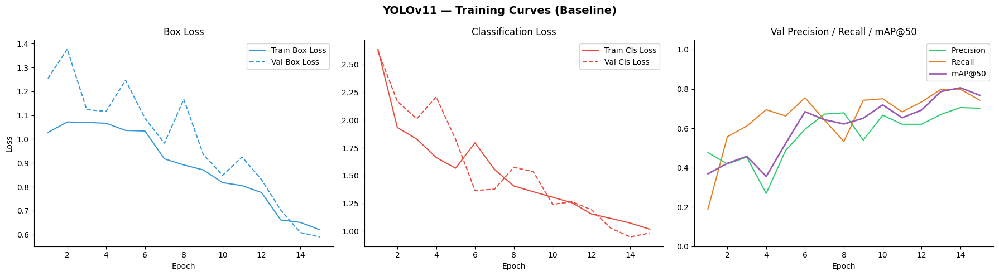

In [15]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 3D — Plot Training Curves                                 ║
# ╚══════════════════════════════════════════════════════════════════╝

import numpy as np
import matplotlib.pyplot as plt

results_csv = RUN_DIR / "results.csv"
res = pd.read_csv(results_csv)
res.columns = res.columns.str.strip()   # YOLO sometimes pads column names

print("Available columns:", list(res.columns))

# Map YOLO column names (may vary slightly between versions)
COL = {
    "epoch"     : "epoch",
    "box_loss_t": next(c for c in res.columns if "train" in c.lower() and "box" in c.lower()),
    "cls_loss_t": next(c for c in res.columns if "train" in c.lower() and "cls" in c.lower()),
    "box_loss_v": next(c for c in res.columns if "val"   in c.lower() and "box" in c.lower()),
    "cls_loss_v": next(c for c in res.columns if "val"   in c.lower() and "cls" in c.lower()),
    "precision" : next(c for c in res.columns if "precision" in c.lower()),
    "recall"    : next(c for c in res.columns if "recall"    in c.lower()),
    "map50"     : next(c for c in res.columns if "map50"     in c.lower() and "95" not in c.lower()),
}

epochs = res[COL["epoch"]]

fig, axes = plt.subplots(1, 3, figsize=(18, 5))
fig.suptitle("YOLOv11 — Training Curves (Baseline)", fontsize=14, fontweight="bold")

# ── Box loss ──────────────────────────────────────────────────────
ax = axes[0]
ax.plot(epochs, res[COL["box_loss_t"]], label="Train Box Loss", color="#3498db")
ax.plot(epochs, res[COL["box_loss_v"]], label="Val Box Loss",   color="#3498db", linestyle="--")
ax.set_title("Box Loss"); ax.set_xlabel("Epoch"); ax.set_ylabel("Loss")
ax.legend(); ax.spines[["top","right"]].set_visible(False)

# ── Cls loss ──────────────────────────────────────────────────────
ax = axes[1]
ax.plot(epochs, res[COL["cls_loss_t"]], label="Train Cls Loss", color="#e74c3c")
ax.plot(epochs, res[COL["cls_loss_v"]], label="Val Cls Loss",   color="#e74c3c", linestyle="--")
ax.set_title("Classification Loss"); ax.set_xlabel("Epoch")
ax.legend(); ax.spines[["top","right"]].set_visible(False)

# ── Precision / Recall / mAP@50 ───────────────────────────────────
ax = axes[2]
ax.plot(epochs, res[COL["precision"]], label="Precision",  color="#2ecc71")
ax.plot(epochs, res[COL["recall"]],    label="Recall",     color="#e67e22")
ax.plot(epochs, res[COL["map50"]],     label="mAP@50",     color="#9b59b6", linewidth=2)
ax.set_title("Val Precision / Recall / mAP@50"); ax.set_xlabel("Epoch")
ax.set_ylim(0, 1.05); ax.legend(); ax.spines[["top","right"]].set_visible(False)

plt.tight_layout()
plt.savefig(RUN_DIR / "training_curves.png", dpi=150, bbox_inches="tight")
plt.show()

Ultralytics 8.4.14 🚀 Python-3.12.12 torch-2.10.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
YOLO11n summary (fused): 101 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2836.3±412.5 MB/s, size: 254.6 KB)
val: Scanning /content/yolo_dataset/labels/train.cache... 839 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 839/839 251.4Mit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 53/53 5.3it/s 10.0s
                   all        839        839      0.769       0.72      0.827      0.694
Speed: 1.7ms preprocess, 3.3ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to /content/runs/detect/val
  Train  P=0.769  R=0.720  F1=0.743  F2=0.729  mAP@50=0.827
Ultralytics 8.4.14 🚀 Python-3.12.12 torch-2.10.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2307.8±418.0 MB/s, size: 263.5 KB)
val: Scanning /content/yolo_dataset/labels

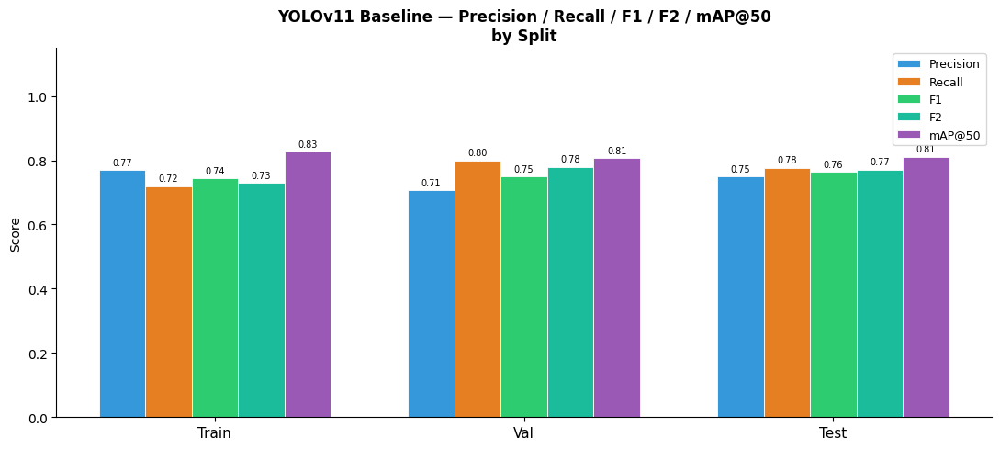


Full metrics table:
Split  Precision  Recall     F1     F2  mAP@50
Train     0.7688  0.7198 0.7435 0.7291  0.8268
  Val     0.7060  0.7996 0.7499 0.7789  0.8064
 Test     0.7500  0.7765 0.7630 0.7710  0.8111


In [16]:
# ╔══════════════════════════════════════════════════════════════════╗
# ║  CELL 3E — Evaluate on Train / Val / Test + F1 / F2 / mAP@50   ║
# ╚══════════════════════════════════════════════════════════════════╝

best_weights = RUN_DIR / "weights" / "best.pt"
eval_model   = YOLO(str(best_weights))

splits_eval = {
    "Train" : YOLO_DIR / "images" / "train",
    "Val"   : YOLO_DIR / "images" / "val",
    "Test"  : YOLO_DIR / "images" / "test_images",
}

def beta_f(precision, recall, beta=1):
    """F-beta score from scalar P and R."""
    b2 = beta ** 2
    denom = b2 * precision + recall
    return (1 + b2) * precision * recall / denom if denom > 0 else 0.0

records = []

for split_name, img_dir in splits_eval.items():
    metrics = eval_model.val(
        data   = str(yaml_path),
        split  = split_name.lower(),
        imgsz  = IMG_SIZE,
        device = 0,
        verbose= False,
    )
    P   = float(metrics.box.mp)        # mean Precision
    R   = float(metrics.box.mr)        # mean Recall
    m50 = float(metrics.box.map50)     # mAP@50
    f1  = beta_f(P, R, beta=1)
    f2  = beta_f(P, R, beta=2)

    records.append({"Split": split_name, "Precision": P, "Recall": R,
                    "F1": f1, "F2": f2, "mAP@50": m50})
    print(f"  {split_name:5s}  P={P:.3f}  R={R:.3f}  F1={f1:.3f}  "
          f"F2={f2:.3f}  mAP@50={m50:.3f}")

metrics_df = pd.DataFrame(records)

# ── Bar chart ─────────────────────────────────────────────────────
fig, ax = plt.subplots(figsize=(11, 5))
x      = np.arange(len(metrics_df))
width  = 0.15
metrics_cols   = ["Precision", "Recall", "F1", "F2", "mAP@50"]
metric_colors  = ["#3498db", "#e67e22", "#2ecc71", "#1abc9c", "#9b59b6"]
offsets        = np.linspace(-(len(metrics_cols)-1)/2, (len(metrics_cols)-1)/2,
                              len(metrics_cols)) * width

for col, color, offset in zip(metrics_cols, metric_colors, offsets):
    bars = ax.bar(x + offset, metrics_df[col], width,
                  label=col, color=color, edgecolor="white", linewidth=0.6)
    for bar in bars:
        h = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2, h + 0.01,
                f"{h:.2f}", ha="center", va="bottom", fontsize=7)

ax.set_xticks(x); ax.set_xticklabels(metrics_df["Split"], fontsize=11)
ax.set_ylim(0, 1.15)
ax.set_ylabel("Score")
ax.set_title("YOLOv11 Baseline — Precision / Recall / F1 / F2 / mAP@50\nby Split",
             fontsize=12, fontweight="bold")
ax.legend(loc="upper right", fontsize=9)
ax.spines[["top","right"]].set_visible(False)
plt.tight_layout()
plt.savefig(RUN_DIR / "eval_metrics.png", dpi=150, bbox_inches="tight")
plt.show()

print("\nFull metrics table:")
print(metrics_df.to_string(index=False, float_format="{:.4f}".format))


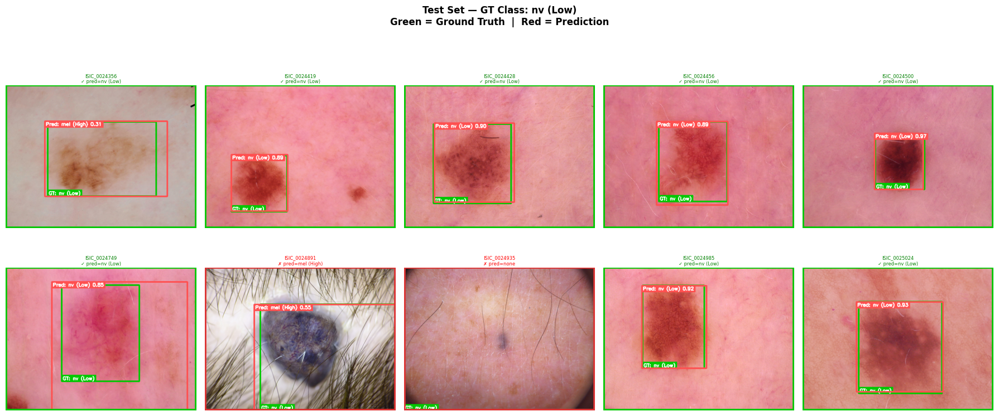

  Class 0 (nv (Low)) — correct: 8/10  (80%)


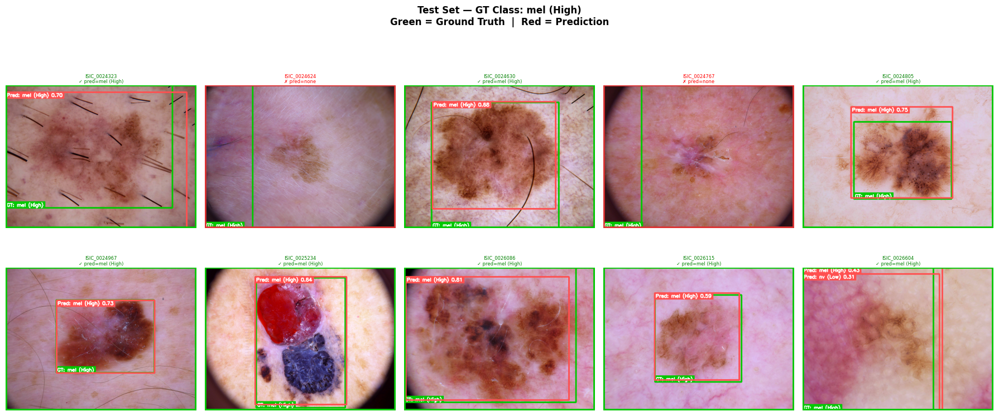

  Class 1 (mel (High)) — correct: 8/10  (80%)

Legend: green frame = correct class | red frame = wrong class
        Green box = GT bbox         | Red box   = Predicted bbox


In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from pathlib import Path

CLASS_NAMES = {0: "nv (Low)",  1: "mel (High)"}
GT_COLOR    = (0,   200, 0)     # green  — ground truth box
PRED_COLOR  = (255, 80,  80)    # red    — prediction box
N_SHOW      = 10
CONF_THRESH = 0.25              # minimum confidence to display a prediction

test_img_dir   = YOLO_DIR / "images" / "test_images"
test_label_dir = YOLO_DIR / "labels" / "test_images"

# ── Run inference on the full test_images split ──────────────────────────────────────
test_images = sorted(test_img_dir.glob("*.jpg"))
predictions = eval_model.predict(
    source    = str(test_img_dir),
    imgsz     = IMG_SIZE,
    device    = 0,
    conf      = CONF_THRESH,
    verbose   = False,
    save      = False,
)

# Index results by stem so we can look them up per image
pred_index = {Path(r.path).stem: r for r in predictions}


def read_yolo_label(label_path, img_w, img_h):
    """Return list of (cls, x1, y1, x2, y2) in pixel coords."""
    boxes = []
    if not Path(label_path).exists():
        return boxes
    with open(label_path) as f:
        for line in f:
            parts = line.strip().split()
            cls, cx, cy, nw, nh = int(parts[0]), *map(float, parts[1:])
            x1 = int((cx - nw / 2) * img_w)
            y1 = int((cy - nh / 2) * img_h)
            x2 = int((cx + nw / 2) * img_w)
            y2 = int((cy + nh / 2) * img_h)
            boxes.append((cls, x1, y1, x2, y2))
    return boxes


def annotate(img_rgb, gt_boxes, pred_result):
    """Draw GT (green) and predicted (red) boxes with labels."""
    canvas = img_rgb.copy()
    h, w   = canvas.shape[:2]

    # ── Ground truth ──────────────────────────────────────────────
    for cls, x1, y1, x2, y2 in gt_boxes:
        cv2.rectangle(canvas, (x1, y1), (x2, y2), GT_COLOR, 3)
        tag = f"GT: {CLASS_NAMES[cls]}"
        (tw, th), _ = cv2.getTextSize(tag, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 2)
        cv2.rectangle(canvas, (x1, y2 - th - 8), (x1 + tw + 6, y2), GT_COLOR, -1)
        cv2.putText(canvas, tag, (x1 + 3, y2 - 4),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

    # ── Predictions ───────────────────────────────────────────────
    if pred_result is not None and len(pred_result.boxes):
        for box in pred_result.boxes:
            conf = float(box.conf[0])
            cls  = int(box.cls[0])
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
            cv2.rectangle(canvas, (x1, y1), (x2, y2), PRED_COLOR, 3)
            tag = f"Pred: {CLASS_NAMES.get(cls, cls)} {conf:.2f}"
            (tw, th), _ = cv2.getTextSize(tag, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 2)
            cv2.rectangle(canvas, (x1, y1), (x1 + tw + 6, y1 + th + 8), PRED_COLOR, -1)
            cv2.putText(canvas, tag, (x1 + 3, y1 + th + 2),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

    return canvas


# ── Bucket test_images images by GT class ────────────────────────────────────────────
by_class = {0: [], 1: []}
for img_path in test_images:
    label_path = test_label_dir / f"{img_path.stem}.txt"
    img_bgr    = cv2.imread(str(img_path))
    img_rgb    = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    h, w       = img_rgb.shape[:2]
    gt_boxes   = read_yolo_label(label_path, w, h)
    if not gt_boxes:
        continue
    gt_cls = gt_boxes[0][0]
    by_class[gt_cls].append((img_path, img_rgb, gt_boxes))

# ── Plot ──────────────────────────────────────────────────────────────────────
for gt_class, items in by_class.items():
    sample   = items[:N_SHOW]
    n        = len(sample)
    fig, axes = plt.subplots(2, 5, figsize=(18, 8))
    fig.suptitle(
        f"Test Set — GT Class: {CLASS_NAMES[gt_class]}\n"
        f"Green = Ground Truth  |  Red = Prediction",
        fontsize=12, fontweight="bold", y=1.01
    )

    correct = 0
    for ax, (img_path, img_rgb, gt_boxes) in zip(axes.flat, sample):
        pred   = pred_index.get(img_path.stem)
        canvas = annotate(img_rgb, gt_boxes, pred)

        # Check if top prediction class matches GT
        pred_cls = None
        if pred is not None and len(pred.boxes):
            pred_cls = int(pred.boxes[0].cls[0])

        match  = pred_cls == gt_class
        correct += int(match)
        border = (0, 200, 0) if match else (220, 50, 50)

        # Thin coloured frame around the whole image to show correct/wrong
        cv2.rectangle(canvas, (0, 0),
                      (canvas.shape[1]-1, canvas.shape[0]-1), border, 8)

        ax.imshow(canvas)
        status = "✓" if match else "✗"
        ax.set_title(f"{img_path.stem}\n{status} pred={CLASS_NAMES.get(pred_cls, 'none')}",
                     fontsize=6, pad=3,
                     color="green" if match else "red")
        ax.axis("off")

    # Hide unused axes if fewer than 10 images
    for ax in axes.flat[n:]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()
    print(f"  Class {gt_class} ({CLASS_NAMES[gt_class]}) — "
          f"correct: {correct}/{n}  ({correct/n*100:.0f}%)")

print("\nLegend: green frame = correct class | red frame = wrong class")
print("        Green box = GT bbox         | Red box   = Predicted bbox")


